# Wildfire fire change detection using Clay v002 embeddings:

This notebook contains an exploration of an application of embeddings, produced by the Clay foundational model, in identifying areas affected by the [2020 California wildfires](https://en.wikipedia.org/wiki/2020_California_wildfires). This was sadly one of the worst wildfire season in the history of California, burning almost 4.4 million hectares of land, 4% of the state's total land, an area comparable to the state of Rhode Island. The wildfires resulted in over $12 billion in damages and sadly, 33 lives lost. 

**Author:** Leo Thomas (leo@developmentseed.org)

**Last updated:** 2024/05/17

## Background: 
A fundamental concept of embeddings is that their position in multi-dimensional space encodes not just key aspects (or features) of the complex input, but that their position _relative to each other_ in multi-dimensional space _also encodes key relationships between these inputs._

Here is an illustration of this concept:

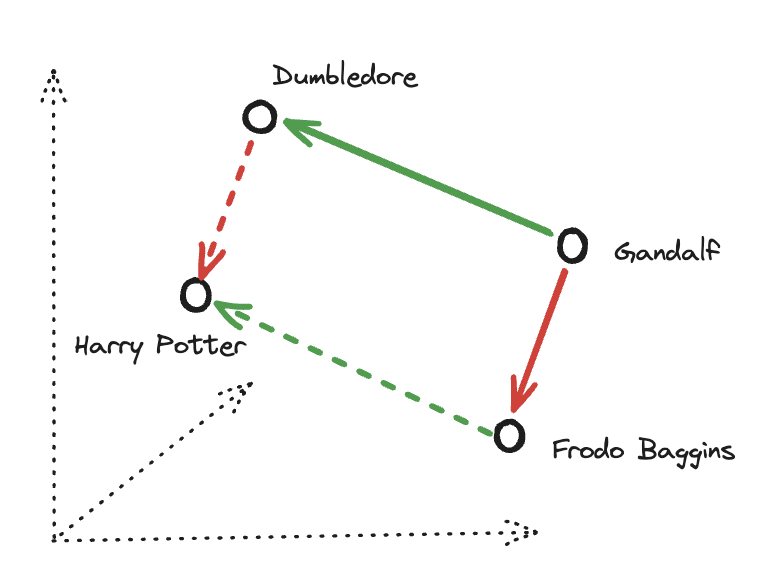

In this case the embeddings for Gandalf the Grey and Frodo Baggins will have a similar position relative to each other in the embedding space as those for Dumbledore and Harry Potter. Similarly the embeddings for Gandalf the Grey and Dumbledore will have a similar position relative to each other as those for Frodo Baggins and Harry Potter. 

Since these embeddings are represented mathematicall as vectors, we can subtract the vectors from each other to produce a vector that represents that relationship. In the above image, the vector pointing from Gandalf to Frodo (in red) encodes a relationship of a bearded wizard to a young man destined to save the world. We expect it to be very similar to the vector pointing from Dumbledore to Harry Potter. The vector pointing from Gandalf to Dumbledore (in green) encodes a relationship between the Lord of the Rings universe and the Harry Potter universe. We could expect that if we added this green vector to the embedding vector for Frodo Bagginsit should point to the embedding vector for Harry Potter.

In the case of the Clay v002 embeddings, we have embeddings from 2020 and 2021. If we identify certain AOIs which contain visible changes from one year to the next, we expect that the vector delta between the embeddings from 2021 and 202 would encode that change, and we could use those vector deltas as a query embedding to find additional locations which contain similar changes from one year to the next. 

The steps are as follows: 
1. Identify an AOI that displays visible changes due to forrest fires (burn scars) in 2020
2. Calculate the pairwise vector difference between 2021 and 2020 for the embeddings of all the chips within this AOI
3. Combine the pairwise vector differences into a single query vector. This vector will thematically represent "burn scars".
4. Load pairwise vector differences between 2021 and 2020 for _all of the v002 embeddings_ into a similarity search engine
5. Perform a similarity search using the query vector to find other chips, outside of the reference AOI, which may also contain burn scars
6. Cross-reference with data from the [California Fire Perimeters dataset](https://gis.data.ca.gov/datasets/CALFIRE-Forestry::california-fire-perimeters-all-1/explore?location=37.844443%2C-120.881293%2C7.00)

## 0. Prequisites: 

### Embeddings: 
The Clay v002 embeddings can be downloaded from S3: `s3://clay-worldcover-embeddings/v002/` (contact leo@developmentseed.org for credentials)

### CA Wildfire Perimeters reference data
For this notebook, we will use the California Wildfires perimeter dataset, which can be [downloaded here](https://gis.data.ca.gov/datasets/CALFIRE-Forestry::california-fire-perimeters-all-1/explore?location=37.844443%2C-120.881293%2C7.00) (click "Download options" on the left, and select "GeoJSON")

In [1]:
# Helper methods
from typing import List
import requests
from functools import lru_cache
from pyproj import Transformer


# Fetch Sentinel 2 images from the Terrascope API (with caching to avoid duplicate requests)
@lru_cache
def fetch_image_data(bbox:str, date:int, width=256):
    bounds = [float(d) for d in bbox.split(",")]
    transformer = Transformer.from_crs(crs_from="EPSG:4326", crs_to="EPSG:3857")
    p1, p2 = transformer.transform(yy=bounds[0], xx=bounds[1]), transformer.transform(yy=bounds[2], xx=bounds[3])
    bounds = [p1[0], p1[1], p2[0], p2[1]] 
    bbox =  ",".join([str(dat) for dat in bounds])
    url = f"https://services.terrascope.be/wms/v2?SERVICE=WMS&version=1.1.1&REQUEST=GetMap&layers=WORLDCOVER_{date}_S2_TCC&BBOX={bbox}&SRS=EPSG:3857&FORMAT=image/png&WIDTH={width}&HEIGHT={width}"
    return requests.get(url).content

## 1. Identify the AOI: 

We will use the burn scar from the [Claremont Fires (2020)](https://en.wikipedia.org/wiki/North_Complex_Fire) as our query AOI. The burns scars are very visible in the Sentinel 2 imagery.

AOI before 2020 fires:


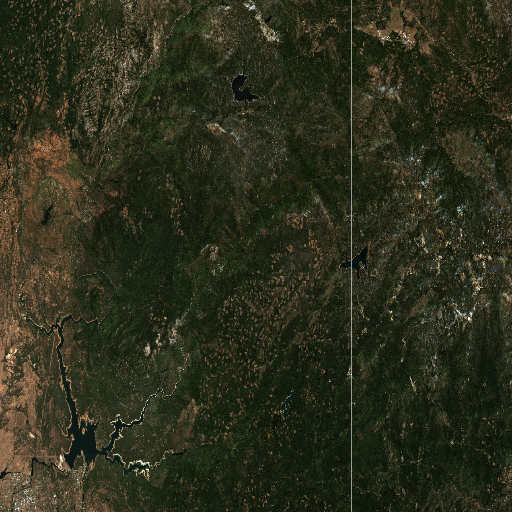

AOI after 2020 fires:


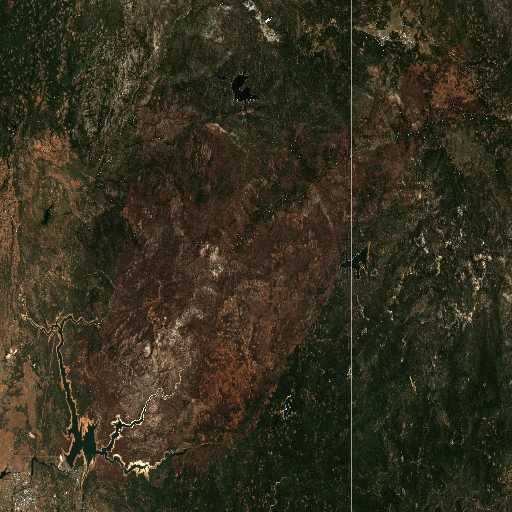

In [2]:
from IPython.display import Image, display

claremont_fires_bounding_box = [-121.60000000000,39.493885674565405,-120.72575427249387,39.972998404342434]

# Convert bounding box to string so the LRU Cache and hash input params
string_bbox = ",".join([str(d) for d in claremont_fires_bounding_box])

print("AOI before 2020 fires:")
display(Image(fetch_image_data(string_bbox, date=2020, width=512)))

print("AOI after 2020 fires:")
display(Image(fetch_image_data(string_bbox, date=2021, width=512)))

## 2. Calculate the pairwise differences (deltas) for the chips within the AOI

We will load the v002 embeddings and find all chips which have at least 90% overlap with the desired AOI and for which we have embeddings for both 2020 and 2021.

In [3]:
from tqdm import tqdm
import concurrent.futures
from pathlib import Path
import geopandas as gpd
import numpy as np

DATA_DIR = Path("./clay-worldcover-embeddings")

# Read all vector embeddings into a list
vector_data_files = list(Path(DATA_DIR).joinpath("v002/2021").glob("*.gpq"))
vector_data_files.extend(list(Path(DATA_DIR).joinpath("v002/2020").glob("*.gpq")))

# Helper function to load the embeddings in a multi-threaded operation
def load(strip):
    tile_df = gpd.read_parquet(strip).to_crs("epsg:4326")
    year = int(str(strip).split("/")[-2])
    data = []
    for _, row in tile_df.iterrows():

        data.append(
            {
                "vector": row["embeddings"],
                "year": year,
                "bbox": row.geometry.bounds,
            }
        )
    return data

with concurrent.futures.ThreadPoolExecutor(25) as executor:
    records_batches = list(
        tqdm(
            executor.map(load, vector_data_files),
            total=len(vector_data_files),
        )
    )

data = [record for batch in records_batches for record in batch]
data = [{"id": i, **record} for i, record in enumerate(data)]


100%|█████████████████████████████████████████████████████████████████| 2718/2718 [00:42<00:00, 63.63it/s]


In [4]:
# Calculates percentage of bbox2 contained within bbox1
def calculate_percentage(bbox1, bbox2):
    # Unpack the bounding boxes
    w1, s1, e1, n1 = (float(b) for b in bbox1)
    w2, s2, e2, n2 = (float(b) for b in bbox2)

    # Calculate the areas of the bounding boxes
    area1 = (e1 - w1) * (n1 - s1)
    area2 = (e2 - w2) * (n2 - s2)

    # Calculate the intersection of the bounding boxes
    w_intersect = max(0, min(e1, e2) - max(w1, w2))
    h_intersect = max(0, min(n1, n2) - max(s1, s2))
    area_intersect = w_intersect * h_intersect

    # Calculate the percentage of bbox2 in bbox1
    percentage = (area_intersect / area2) * 100

    return percentage

#find all tiles that overlap at least 50% with out reference AOI
overlap_chips = [
    {**d, "overlap": calculate_percentage(claremont_fires_bounding_box, d["bbox"])} 
    for d in tqdm(data) if calculate_percentage(claremont_fires_bounding_box, d["bbox"]) > 90
]

# We find 309 chips that overlap with our AOI. 
# Since this includes both chips from 2020 and 2021, and is an uneven number, 
# we know that there are some chips for which we don't have embeddings for both years. 
# We will subtract those chips in the next step
print(len(overlap_chips))

100%|█████████████████████████████████████████████████████████| 942715/942715 [00:01<00:00, 580741.70it/s]

309


In [5]:
# In order to match up pairs of embeddings, we create a dict
# which will use the string bounding box as keys
pairs = {}

for d in tqdm(overlap_chips): 
    pairs.setdefault(",".join([str(b) for b in d["bbox"]]), {}).update({d["year"]:d})

# Assert no chips are triplicated
assert len([{k:v} for k,v in pairs.items() if len(v)>2]) == 0

# Remove chips which don't have embeddings for BOTH years
print(f"Number of single chips to remove: {len([{k:v} for k,v in pairs.items() if len(v)<2])}")
pairs = {k:v for k,v in pairs.items() if len(v)==2}

print(f"Number of chip pairs present in BOTH years: {len(pairs)}")

100%|███████████████████████████████████████████████████████████████| 309/309 [00:00<00:00, 543869.05it/s]

Number of single chips to remove: 127
Number of chip pairs present in BOTH years: 91


In [6]:
# Calculate the deltas for each pair of chips within the AOI
delta_vectors = np.array([v[2021]['vector'] - v[2020]['vector'] for k,v in pairs.items()])
delta_vectors.shape

(91, 768)

## 2.1. Exploring the AOI deltas

We will quickly explore the distribution of the delta vectors by plotting a histogram of their magnitudes. Since not _all_ of the chips within our AOI contain burn scar evidence, we expect that many of the delta vectors for our AOI will have a magnitude close to zero, since the would be very little change between the embeddings from 2020 and 2021 and we expect to see a small concentration of delta vectors with a large magnitude, which represent those chips with more significant difference between 2020 and 2021.

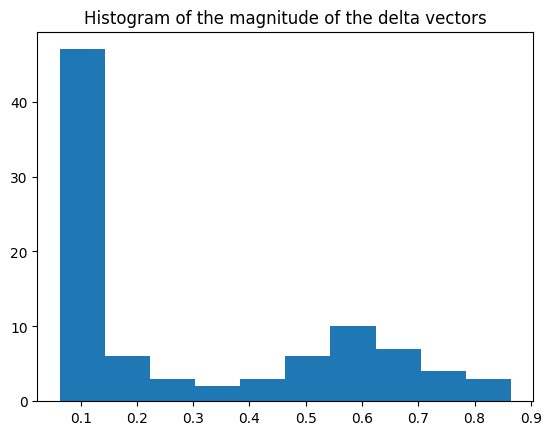

In [7]:
import matplotlib.pyplot as plt
fig, axs = plt.subplots()
hist = plt.hist(x=[np.linalg.norm(d) for d in delta_vectors],bins=10)
axs.set_title("Histogram of the magnitude of the delta vectors")
plt.show()

We can filter our delta vectors with very small magnitude,
since those correspond to chips with little meaningful change from 2020 to 2021.
In practice this doesn't make a huge difference, since their magnitude is small, 
they carry little weight when averageing all of the delta vectors from the AOI

In [8]:
query_vectors = np.array([d for d in delta_vectors if np.linalg.norm(d)>0.3])

## 3. Calculate the query vector as the average of the delta vectors
This query vector encodes the visual elements of wildfire burn scars

In [9]:
query_vector = query_vectors.mean(axis=0)
query_vector.shape

(768,)

## 4. Load vector deltas for the entire v002 emebddings set into a similarity search engine

We will again use a dictionairy to match embeddings from 2020 and 2021 for each chip, and filter out any singles

In [10]:
pairs = {}

for d in tqdm(data): 
    pairs.setdefault(",".join([str(b) for b in d["bbox"]]), {}).update({d["year"]:d})
# Assert no chips are triplicated
assert len([{k:v} for k,v in pairs.items() if len(v)>2]) == 0

print(f"Number of single chips to remove: {len([{k:v} for k,v in pairs.items() if len(v)<2])}")
pairs = {k:v for k,v in pairs.items() if len(v)==2}

print(f"Number of chip pairs present in BOTH years: {len(pairs)}")

deltas = [{**v[2021], 'vector': v[2021]['vector']-v[2020]['vector']} for v in tqdm(pairs.values())]


100%|█████████████████████████████████████████████████████████| 942715/942715 [00:01<00:00, 474383.60it/s]


Number of single chips to remove: 33251
Number of chip pairs present in BOTH years: 454732


100%|█████████████████████████████████████████████████████████| 454732/454732 [00:01<00:00, 402478.21it/s]


In [11]:
# Load the delta vectors for the whole set into LanceDB 
import lancedb

TABLE_NAME="change-detection"
vector_database = lancedb.connect(DATA_DIR)

if TABLE_NAME in vector_database.table_names():
    print(f"Dropping existing table: {TABLE_NAME}")
    vector_database.drop_table(TABLE_NAME)

table = vector_database.create_table(TABLE_NAME, data=deltas, mode="overwrite")
print(f"Table loaded with {len(table)} records")

Dropping existing table: change-detection


[2024-05-17T21:23:10Z WARN  lance::dataset] No existing dataset at /Users/leo/development-seed/clay-foundation/model/src/similarity_search_demo/clay-worldcover-embeddings/change-detection.lance, it will be created


Table loaded with 454732 records


In [12]:
table.head()

pyarrow.Table
id: int64
vector: fixed_size_list<item: float>[768]
  child 0, item: float
year: int64
bbox: list<item: double>
  child 0, item: double
----
id: [[0,1,2,3,4]]
vector: [[[0.000016863458,0.0015407121,0.00053514354,-0.0024915114,0.0009721732,...,0.005340821,0.0006235866,0.0023721159,-0.0011240803,-0.0035973676],[-0.00042714877,0.0034540454,0.001369694,-0.0013831686,-0.0004396625,...,0.006892343,-0.00025805645,0.003841333,0.0018711425,-0.0054310597],[-0.00054294756,0.0011171903,0.00015125936,-0.0014952831,0.00044749584,...,0.006640994,-0.0009794291,0.0031532831,-0.000045323744,-0.00071402267],[-0.00023199571,0.0013804361,0.00090699596,-0.0013788007,0.00024242327,...,0.0075999964,-0.0010800082,0.002113238,0.00024609268,0.00042628124],[-0.00038960483,0.0027770437,0.0010278542,-0.0024446864,0.000023530796,...,0.0033069712,-0.0005647037,-0.00022352487,0.00079666823,-0.004289791]]]
year: [[2021,2021,2021,2021,2021]]
bbox: [[[-117.70400000000001,49.53066666666667,-117.6613333333333

## 5. Run a similarity search on the query against the indexed delta vectors
When we run the similairty search on the query vector against the indexed delta vectors, we notice that the resulting chips are all distinctly "redder" in 2021 than in 2020, a posible indication of wildfire.

Coords: ([-122.99466666666666, 39.93066666666667, -122.952, 39.973333333333336]), distance: 0.0028508901596069336


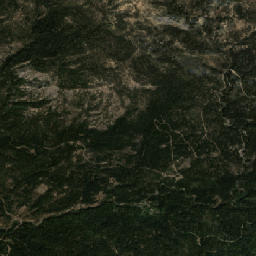

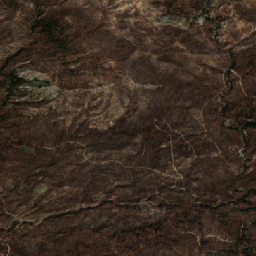

Coords: ([-121.33066666666667, 39.67466666666667, -121.288, 39.717333333333336]), distance: 0.0030347108840942383


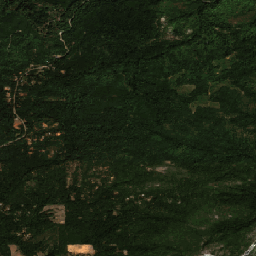

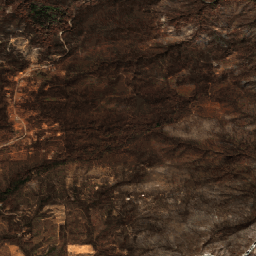

Coords: ([-121.37333333333333, 39.67466666666667, -121.33066666666667, 39.717333333333336]), distance: 0.0031314492225646973


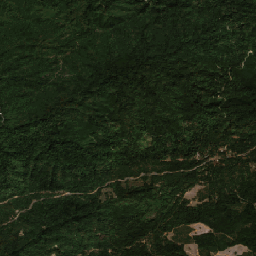

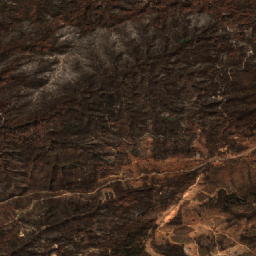

Coords: ([-121.288, 39.632, -121.24533333333333, 39.67466666666667]), distance: 0.0034686923027038574


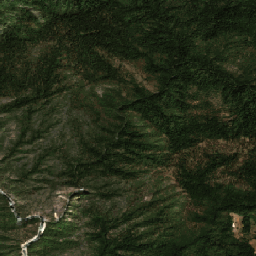

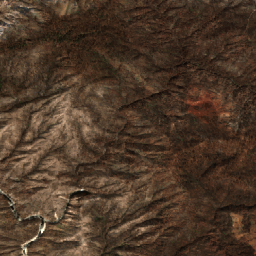

Coords: ([-121.20266666666667, 39.632, -121.16, 39.67466666666667]), distance: 0.004207909107208252


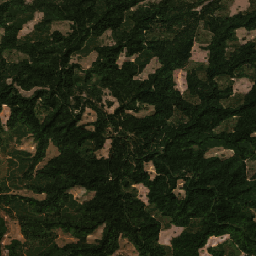

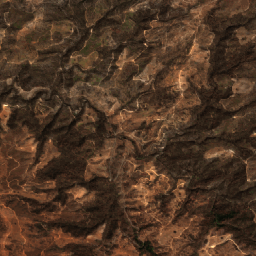

In [13]:
# Run a similarity search 
results = table.search(query=query_vector, vector_column_name="vector").metric('cosine').limit(5).to_list()

# Pull Sentinel 2 chips from the Terrascope API
for r in results: 
    print(f"Coords: ({r['bbox']}), distance: {r['_distance']}")
    bbox_string = ",".join([str(b) for b in r["bbox"]])
    display(Image(fetch_image_data(bbox_string, date=2020, width=256)))
    display(Image(fetch_image_data(bbox_string, date=2021, width=256)))

## 6. Cross reference the results:

We will display the bounding boxes of the chips with positive burn scare detections in blue, and the reference wildfire burn perimeters in pink (note: some military bases and tribal lands are displayed in a very similar shade of pink on the base map)

In [14]:
# Create a new map instance
from ipyleaflet import Map, Rectangle, Marker, GeoJSON, Polygon, FullScreenControl

m = Map(center=(36.7783, -119.4179), zoom=5, scroll_wheel_zoom=True, controls=[FullScreenControl()])

In [15]:
# Run the similarity search, increasing the number of desired results
results = table.search(query=query_vector, vector_column_name="vector").metric('cosine').limit(1000).to_list()

# Add the results of our similarity search to the map
for r in results: 
    # Note: IPyleaflet expects coordinates to be in LON, LAT order    
    m.add(Rectangle(bounds=((r['bbox'][1],r['bbox'][0]), (r['bbox'][3],r['bbox'][2])), fill_opacity=0))

In [16]:
# Add the reference forrest fire perimeters
from shapely.geometry import shape, mapping
from shapely.ops import transform
import geojson

with open("California_Fire_Perimeters_7897608464518632307.geojson") as f:
    gj = geojson.load(f)

# Filter out the fires other than those from 2020
polygons = [
    f.geometry for f in gj.features 
    if f.properties['YEAR_'] and 2019 < int(f.properties['YEAR_']) < 2021
]

# Convert the polygons from EPSG:3857 to lat/lon and plot on the map
transformer = Transformer.from_crs(crs_from="EPSG:3857", crs_to="EPSG:4326")
for p in polygons:
    p = mapping(transform(transformer.transform, shape(p)))
    m.add(Polygon(locations=p['coordinates'], color="red", opacity=1, fill_color="red", weight=0))

In [17]:
# Display the results of our hard work!
m

Map(center=[36.7783, -119.4179], controls=(FullScreenControl(options=['position']), ZoomControl(options=['posi…

# Screenshots: 

The August Complex (left) and Claremont fires (right - this was our reference AOI). The August Complex is almost completely and exactly identified. The Claremont fires are partially identified, which is surpising since it was our input data. However, we did notice that certain number of chips did not have embeddings for both years, so we may be missing data in the area: 

<img src=attachment:d306cf35-25a7-4d7d-97b7-7717eef3db7d.png width=400>
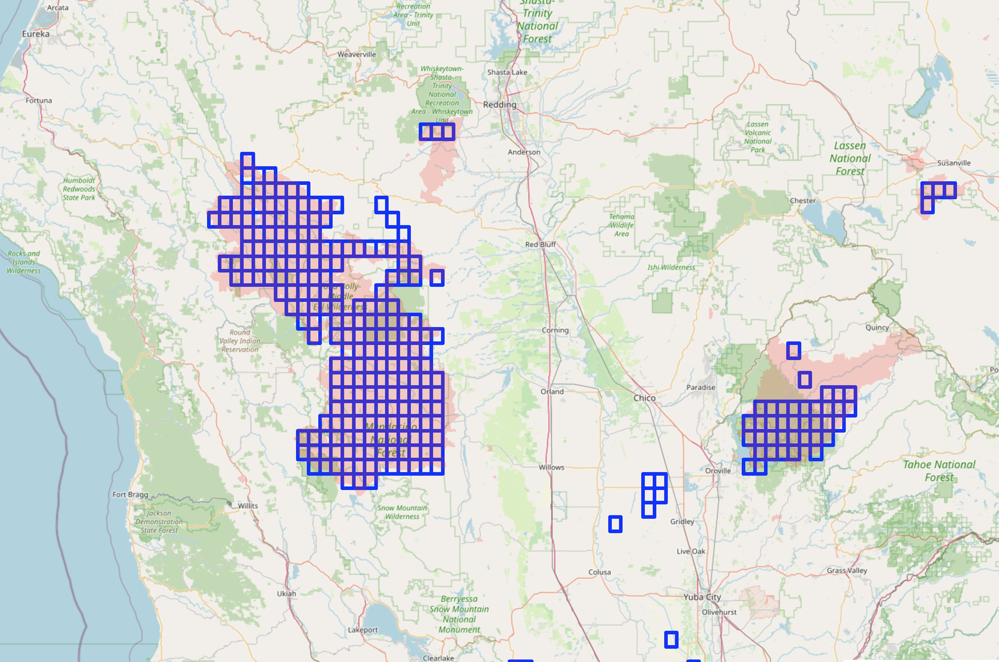

The Slater and Devil fires, on the border of Oregon and California (above) and the Red Salmon Complex fires are identified: 
<img src=attachment:b7577368-8039-4e80-b2b2-fdef242c9b2f.png width=400>
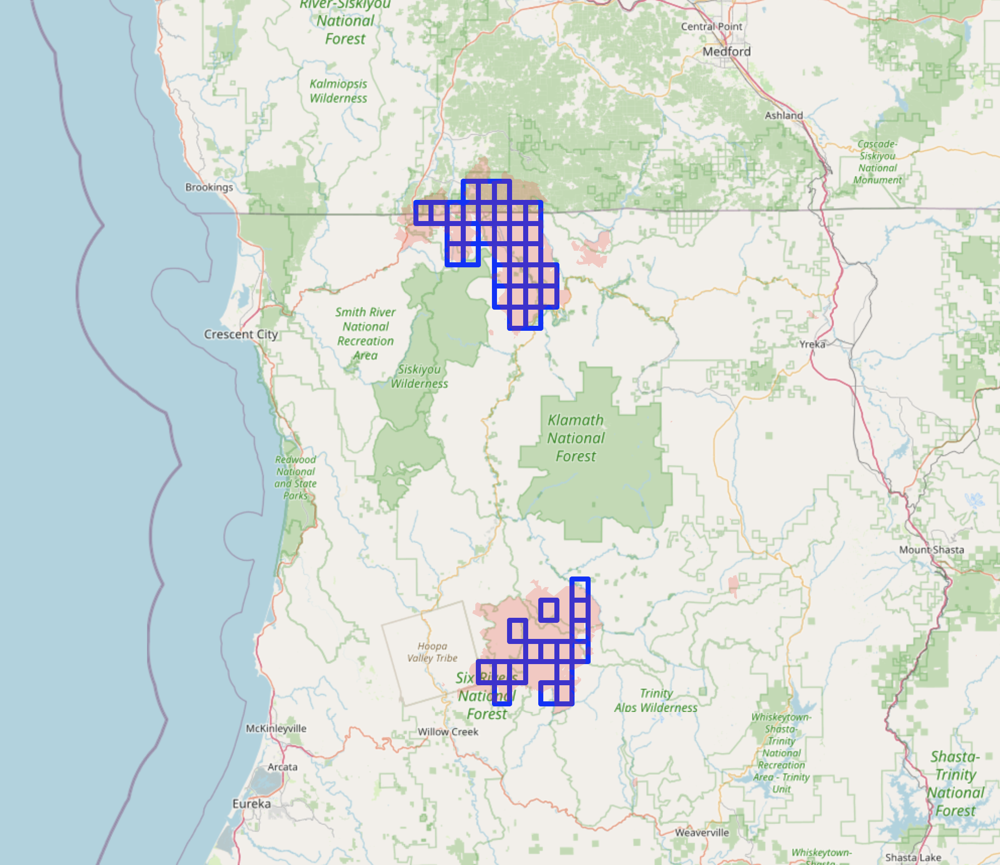

The Dolan Fire (south of Monterrey), SCU Lightning Complex (east of San Jose), CZU Lightning Complex (north of Santa Cruz) and Creek Fire (north-east of Fresno): 

<img src=attachment:5426a656-7ab3-4103-824c-dec43ad1a5ad.png width=400>
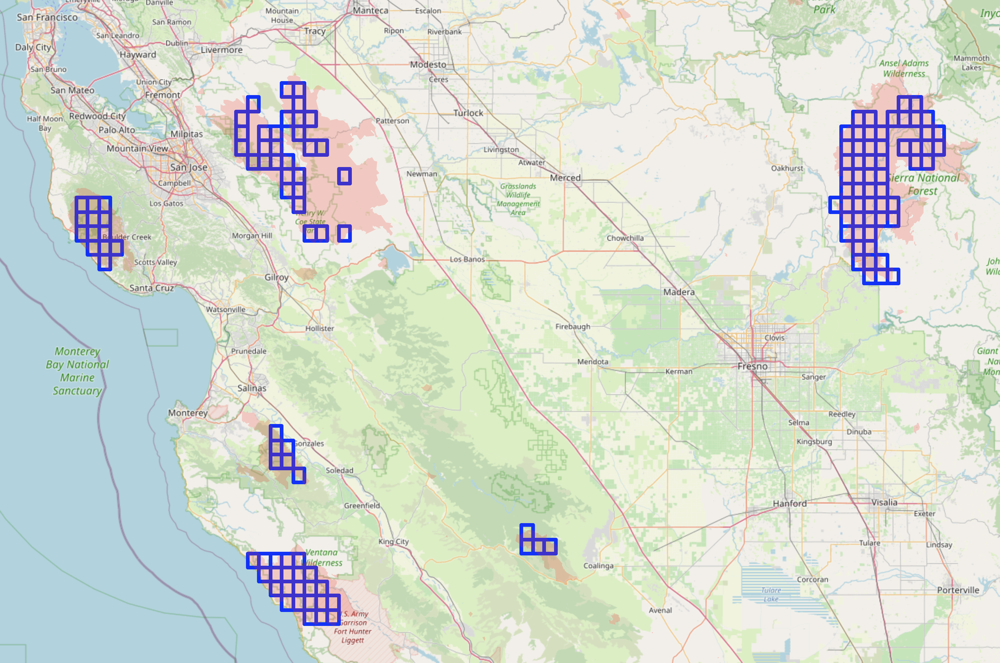

The Lake and Bobcat fires, north of Los Angeles, El Dorado fire, east of Los Angeles, and some false positives just north of Santa Monica: 
<img src=attachment:e34e5da5-3360-43f7-98bd-f4c6a6a44633.png width=400>
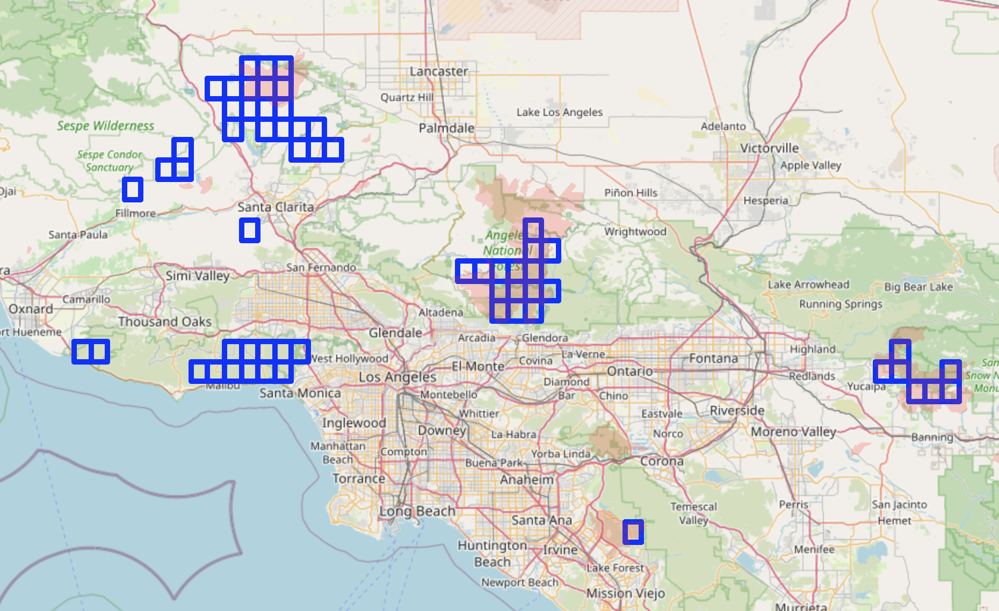

Some false negatives in north-eastern California (near the borders of Oregon and Nevada): 

<img src=attachment:b386f8fc-e731-44e8-8c17-e8baf61895bb.png width=400>
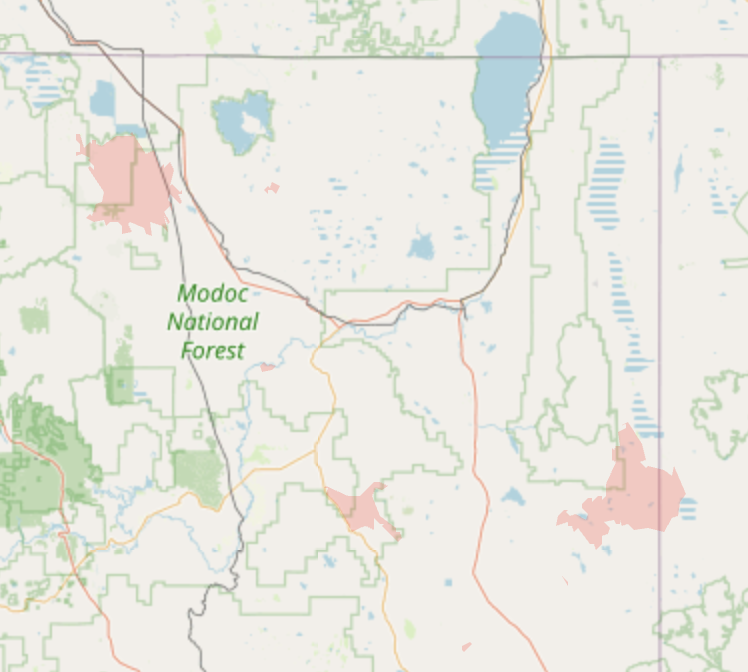

An overview of the western US: 

<img src=attachment:32f8ef89-0dde-438c-9617-b0b0fad87358.png width=400>

While we haven't cross-referenced the detections in Orgeon, Idaho, Washington, southern British Columbia and near Denver, these are all very likely to be wildfires as well
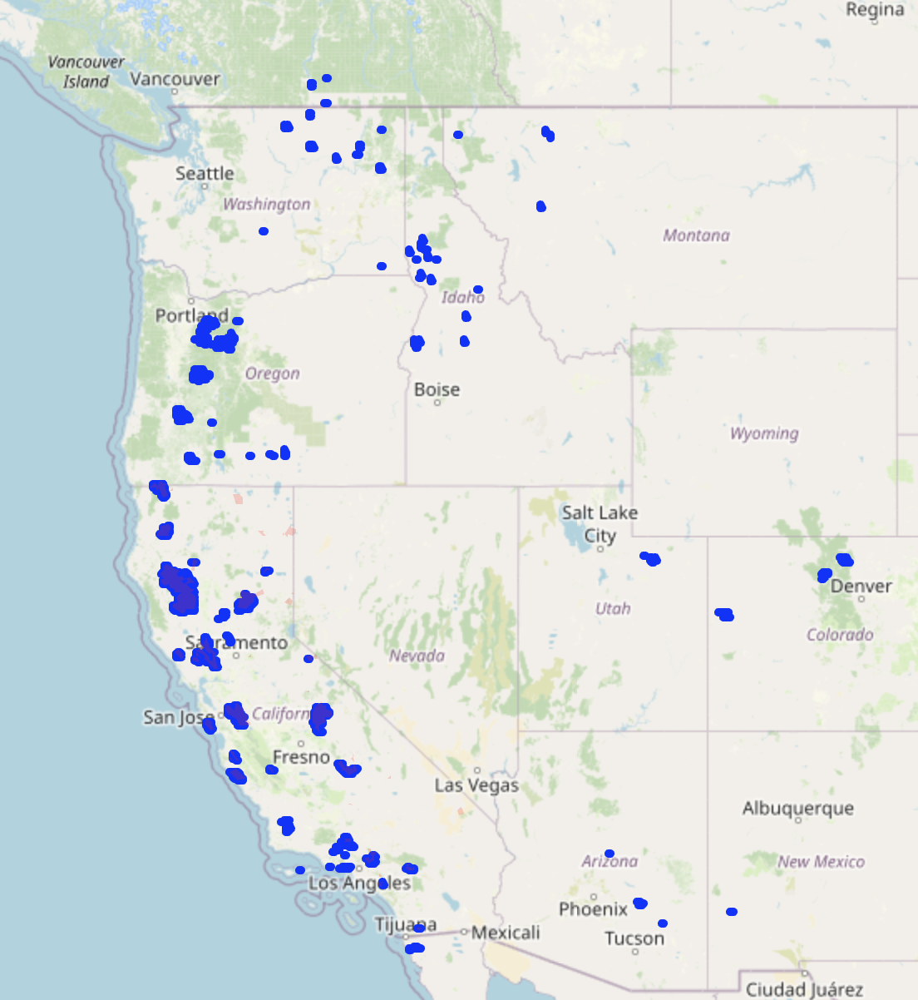

An overview of the eastern US: 

<img src=attachment:840467b6-5b6b-4a46-b7dd-b0b72e38bbfd.png width=400>

An interesting cluster to note is the one in northern New Hampshire and Southern Quebec. This seems to correspond to the [Connecticut Lakes Headwaters Working Forest](https://www.nhstateparks.org/find-parks-trails/connecticut-lakes-headwaters-working-forest), where there is a lot of timber logging activity. Looking at a screenshot from terrascope, it looks we might be picking up on deforestation from that logging: 

<img src=attachment:9c745485-8f2f-4d02-8b13-344413cac314.png width=400>

I'm intrigued by the clusters in south Texas and around Charlotte North Carolina. If anyone knows anything about wildfires in these areas in 2020, please reach out!

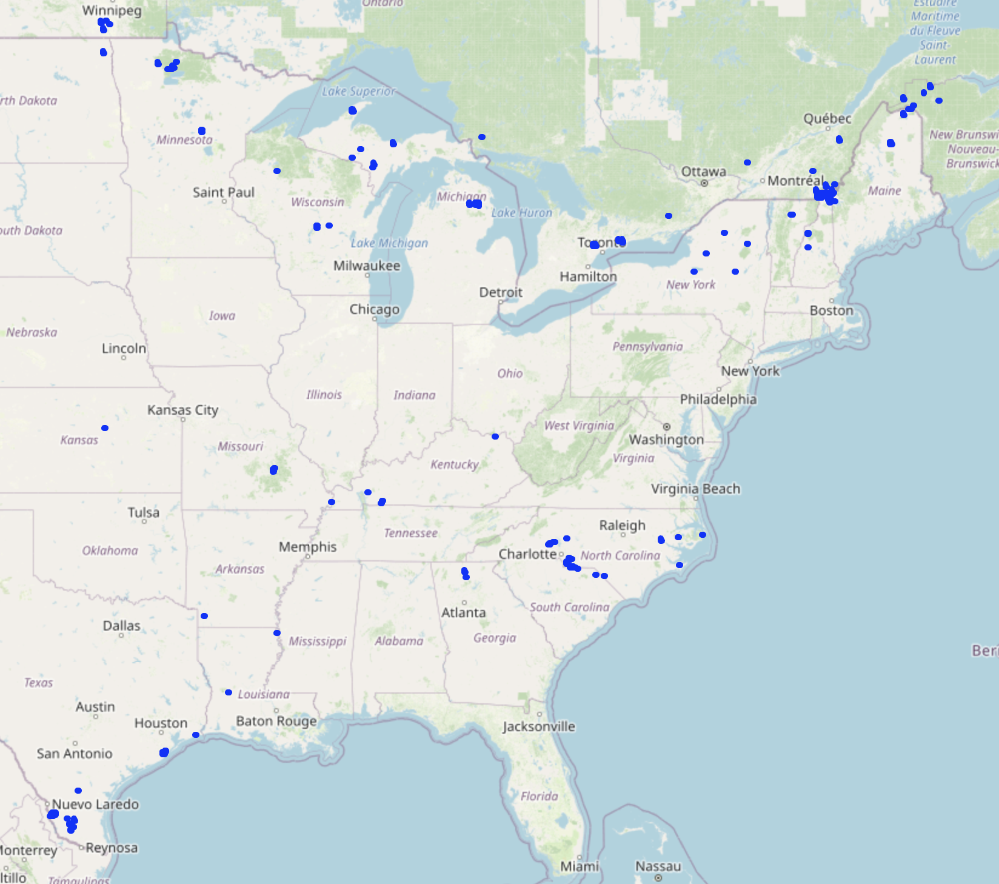
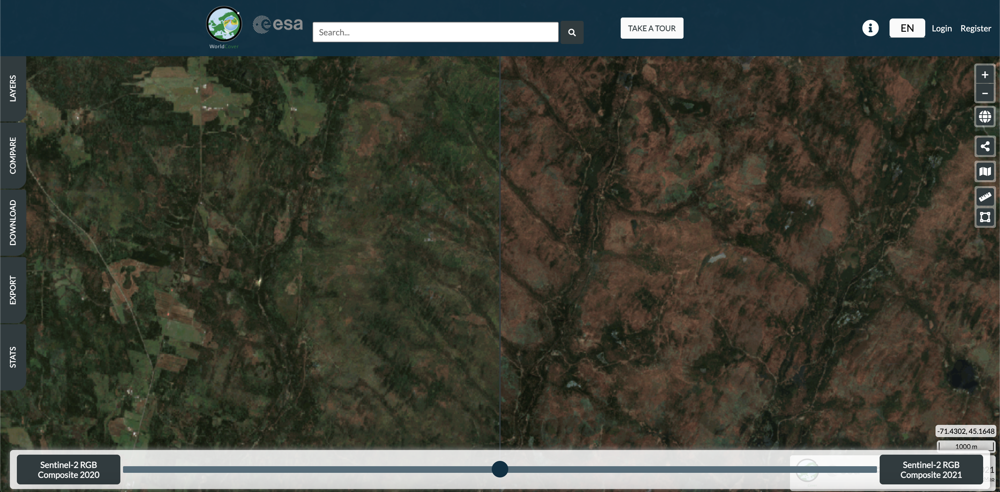

## Comparison to similarity search directly on the AOI embeddings
To validate the effectiveness of this approach over a simple similarity search which just the 2021 embeddings of the AOI where the burn scar is visible (not the delta vectors). Note: we will have to load the table with the all of the original embeddings, rather than the delta embeddings 

In [18]:
TABLE_NAME="similarity-search"
vector_database = lancedb.connect(DATA_DIR)

if TABLE_NAME in vector_database.table_names():
    print(f"Dropping existing table: {TABLE_NAME}")
    vector_database.drop_table(TABLE_NAME)

table = vector_database.create_table(TABLE_NAME, data=data, mode="overwrite")

Dropping existing table: similarity-search


[2024-05-17T21:24:12Z WARN  lance::dataset] No existing dataset at /Users/leo/development-seed/clay-foundation/model/src/similarity_search_demo/clay-worldcover-embeddings/similarity-search.lance, it will be created


In [19]:
# Create a new map instance
m2 = Map(center=(36.7783, -119.4179), zoom=5, scroll_wheel_zoom=True, controls=[FullScreenControl()])

In [20]:
# Create a new query vector, using the embeddings from the AOI, from the year 2021 (where the burn scar is visible)
chips_2021 = [c for c in overlap_chips if c['year']==2021]
query_vector = np.array([c['vector'] for c in overlap_chips if c['year'] == 2021]).mean(axis=0)

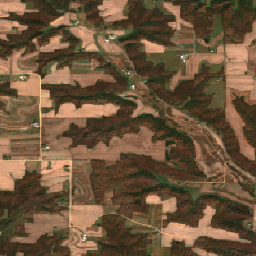

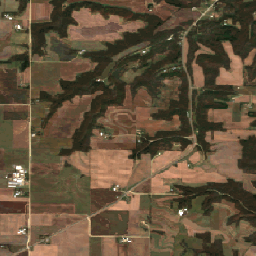

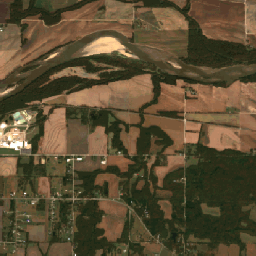

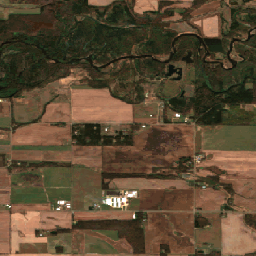

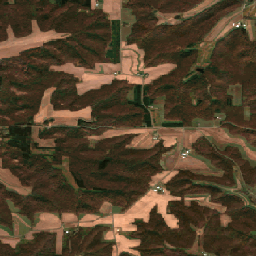

In [21]:
# Run the similarity search using this new, averaged vector
results = table.search(query=query_vector, vector_column_name="vector").metric('cosine').limit(1000).to_list()
for r in results[:5]: 
    bbox_string = ",".join([str(d) for d in r['bbox']])
    display(Image(fetch_image_data(bbox_string, date=2020, width=256)))


In [22]:
# Add the results of our similarity search to the map
for r in results: 
    # Note: IPyleaflet expects coordinates to be in LON, LAT order (rather than the lat/lon order in the bbox)    
    m2.add(Rectangle(bounds=((r['bbox'][1],r['bbox'][0]), (r['bbox'][3],r['bbox'][2])), fill_opacity=0))

In [23]:
# Convert the polygons from EPSG:3857 to lat/lon and plot on the map
transformer = Transformer.from_crs(crs_from="EPSG:3857", crs_to="EPSG:4326")
for p in polygons:
    p = mapping(transform(transformer.transform, shape(p)))
    m2.add(Polygon(locations=p['coordinates'], color="red", opacity=1, fill_color="red", weight=0))

In [24]:
m2

Map(center=[36.7783, -119.4179], controls=(FullScreenControl(options=['position']), ZoomControl(options=['posi…

As expected, we find that, while *some* of the result chips correspond to areas with burns scars, the vast majority do not. In this case, the simiarity search is quite senesive to the color distribution of the chips. The chips with visible burn scars have deep reddish brown colours with some green. This is reflected in the large cluster of results over the southwestern US, which is quite arid, and in the midwest where there are large amounds of corn and wheat fields also containing similar tones of brown.

Eg: 

<img src=attachment:616ef648-e542-4c2f-b4c6-17a6bb39e259.png width=400>
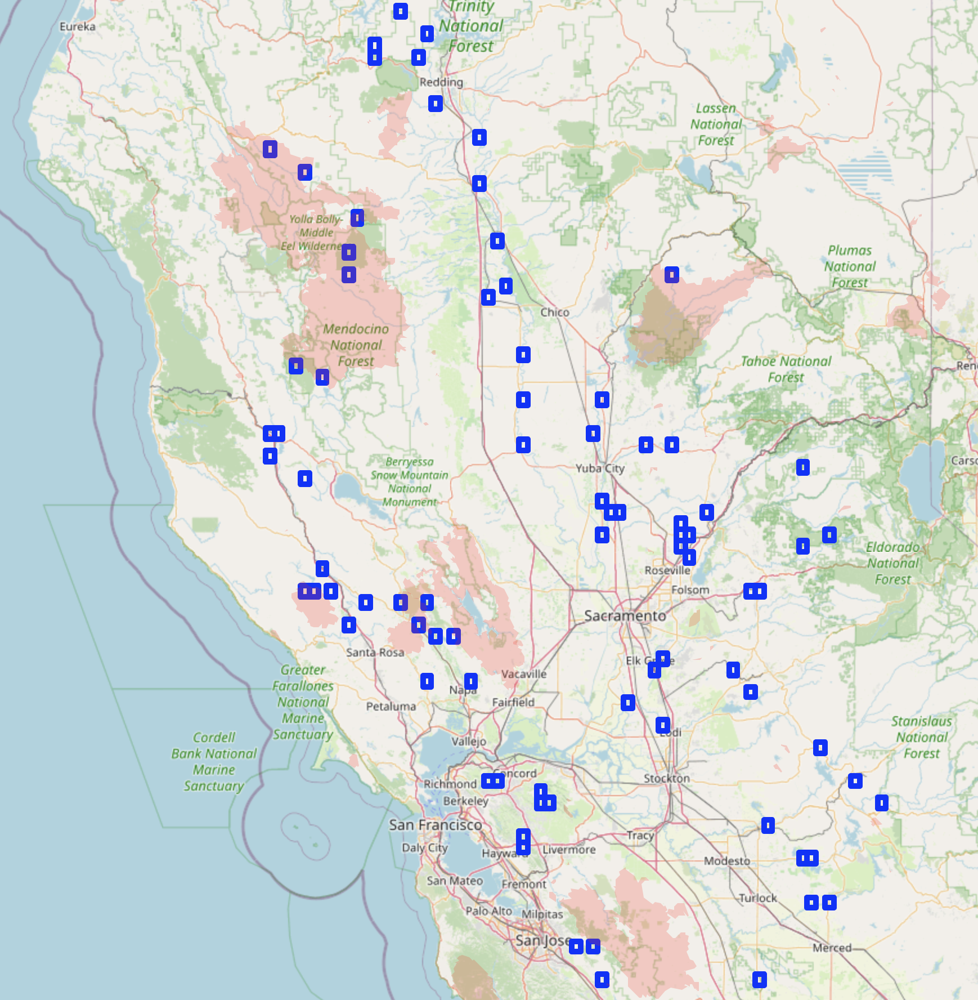

# Further exploration: 
- Clustering (see below): the similarity search approach find vectors within a certain distance of the input/query vector. A more complete approach could include clustering the dataset using T-SNE (see below) to identify clusters, belonging to various types of change. We could establish clusters for things to like coastal erosion, flooding, urban development, mining, etc.
- Establishing an F1 score: this would entail restricting the delta vectors search to only california and then calculating the intersection between the detected chips and the reference area. This can be used to evaluate the impact of various parameters/optimzations on the change detection (eg: the distance metric used for the similarity search, or a feedback approach where validated detections are used in the query vector for the next search
- Re-running the above analysis using more recent data


## Misc: Clustering

I attempted to cluster the delta vectors from our query to see if any interesting patterns emerged, with not obvious results, but I've kept the code here as a possibilty for further exploration. 

In [25]:
# T-SNE dimensionality reduction
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

tsne_reduced = TSNE(n_components=2, learning_rate='auto',
                   init='random', perplexity=30).fit_transform(delta_vectors)
tsne_reduced.shape

(91, 2)

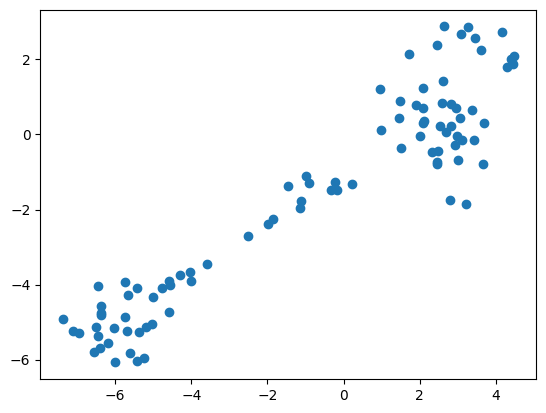

In [26]:
plt.scatter(tsne_reduced[:, 0], tsne_reduced[:,1])
plt.show()

In [27]:
# PCA dimensionality reduction
from sklearn.decomposition import PCA
pca_reduced = PCA(n_components=2).fit_transform(np.array([d['vector'] for d in deltas]))
pca_reduced.shape

(454732, 2)

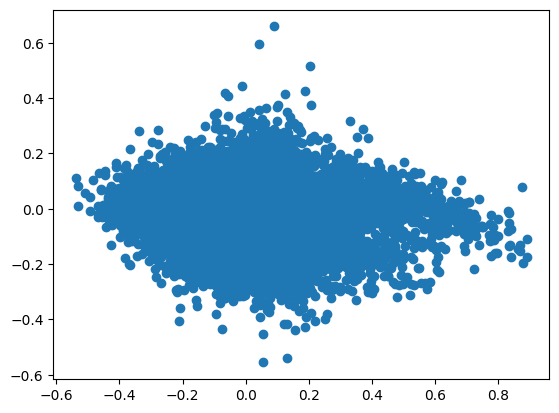

In [28]:
plt.scatter(pca_reduced[:, 0], pca_reduced[:,1])
plt.show()

In [29]:
# Note: this command attempts of perform a T-SNE clustering of the vector deltas for 
# the entire set (~450k elements) which is very computationally expensive. I 
# tsne_reduced_full_set = TSNE(n_components=2, learning_rate='auto',
#                    init='random', perplexity=10).fit_transform(np.array([d['vector'] for d in deltas]))
# tsne_reduced_full_set.shape

In [30]:
# plt.scatter(tsne_reduced_full_set[:, 0], tsne_reduced_full_set[:,1])
# plt.show()